# Modelling Mail-In Votes In the 2020 US Election

## Author

* **Eric Daub**, Alan Turing Institute, GitHub: [@edaub](https://github.com/edaub).

## Other Contributors

* **Camila Rangel Smith**, Alan Turing Institute, GitHub: [@crangelsmith](https://github.com/crangelsmith). Twitter: [@CamilaRangelS](https://twitter.com/CamilaRangelS).
* **Martin O'Reilly**, Alan Turing Institute, Github: [@martintoreilly](https://github.com/martintoreilly).

## Reviewers

## Introduction

The Covid-19 Pandemic led to record numbers of mail-in votes in the 2020
United States Presidential Election. Because of the high volume of mail
ballots, plus rules that prevented some states from counting these ballots
before election day, the result of the election remained uncertain for
a week, with periodic updates coming as ballots were tabulated and reported.

In particular, several states had very close races that had the potential
to tip the election in favor of either candidate. Because of the Electoral
College system, where states almost universally employ a "winner-take-all"
model for allocating their Electoral Votes, a few states can have a large
effect on the outcome of the election. For example, in 2000 the election
came down to around a 500 vote margin in Florida (out of 10 million
ballots cast), despite the fact that Al Gore easily won the popular vote.
In 2020, a few states with very close races dominated the headlines for the
week after the election, of which we will look at Pennsylvania, Arizona,
and Georgia in this post. The final outcome of the election hung on the
results from these states, and the slow drip feed of additional ballots
being released left audiences constantly checking the news for updates.

In this Turing Data Story, I examine a few ways to analyze the data updates
coming from each state to predict the final outcome. This originated from
some Slack discussions with Camila Rangel Smith and Martin O'Reilly, whom
I list above as contributors for this reason. In particular, our initial
interest in this question centered around uncertainties in the analysis done
by Camila and Martin, which I have carried out using Bayesian inference to
quantify uncertainty and determine when we might have reasonably called each
state for the eventual winner based on the updated data.

## Data

To create the models in the post, I use the
[NYT Election Data Scraper](https://alex.github.io/nyt-2020-election-scraper)
to obtain the latest results which are updated every few minutes to ensure
that they have the latest data. To load this data into a Python session
for analysis, I can use Pandas to simply load from the CSV version of the
data directly from the URL, and extract the state that I wish to examine:

In [1]:
%matplotlib inline

In [2]:
import pandas
import datetime

def load_data(state, timestamp=None):
    """
    Loads election data updates from CSV file as a pandas data frame

    Retrieves data from the live file on Github, which is loaded into a
    data frame before extracting the relevant state data.

    State must be a string, which will be searched in the "state" field
    of the data frame.

    Timestamp must be a datetime string. Optional, default is current
    date and time.

    Returns a data frame holding all updates from a particular state,
    prior to the given timestamp. The "vote_differential" field is turned
    into a signed margin that is positive for a Biden lead. Also adds
    columns for the number of votes for Biden and Trump.
    """

    if timestamp is None:
       timestamp = datetime.datetime.now().strftime("%Y-%m-%dT%H:%M:%S")

    try:
        data = pandas.read_csv("https://alex.github.io/nyt-2020-election-scraper/battleground-state-changes.csv")
    except:
        data = pandas.read_csv("battleground-state-changes.csv")

    data.loc[data["leading_candidate_name"] == "Trump", "vote_differential"] \
        = -data.loc[data["leading_candidate_name"] == "Trump", "vote_differential"]

    data["biden_votes"] = None
    data.loc[data["leading_candidate_name"] == "Biden", "biden_votes"] \
        = data.loc[data["leading_candidate_name"] == "Biden", "leading_candidate_votes"]
    data.loc[data["trailing_candidate_name"] == "Biden", "biden_votes"] \
        = data.loc[data["trailing_candidate_name"] == "Biden", "trailing_candidate_votes"]

    data["trump_votes"] = None
    data.loc[data["leading_candidate_name"] == "Trump", "trump_votes"] \
        = data.loc[data["leading_candidate_name"] == "Trump", "leading_candidate_votes"]
    data.loc[data["trailing_candidate_name"] == "Trump", "trump_votes"] \
        = data.loc[data["trailing_candidate_name"] == "Trump", "trailing_candidate_votes"] 			           

    data["timestamp"] = pandas.to_datetime(data["timestamp"])
    data = data[data["timestamp"] < pandas.to_datetime(timestamp)]

    return data[data["state"].str.contains(state)]

Note that rather than specifying the leading and trailing candidates, I instead
just convert the vote differential into a margin that is positive if Biden
is leading and negative if Trump is leading. I also add columns for the total
number of votes for Biden and Trump, which I will use later.

For instance, if I would like to see the data for Georgia:

In [3]:
df = load_data("Georgia")
df.head()

,state,timestamp,leading_candidate_name,trailing_candidate_name,leading_candidate_votes,trailing_candidate_votes,vote_differential,votes_remaining,new_votes,new_votes_relevant,...,trailing_candidate_partition,precincts_reporting,precincts_total,hurdle,hurdle_change,hurdle_mov_avg,counties_partition,total_votes_count,biden_votes,trump_votes
112,Georgia (EV: 16),2020-12-07 20:17:22.360,Biden,Trump,2473633,2461854,11779,-2224,-8,1,...,75.000000,2655,2655,0.0,0.0,0.360367,{},4997716,2473633,2461854
113,Georgia (EV: 16),2020-12-05 00:26:57.152,Biden,Trump,2473707,2461779,11928,-2232,-842,-858,...,0.067599,2655,2655,0.0,0.0,0.368200,"{'Appling': 49, 'Ben Hill': 4, 'Bleckley': 2, ...",4997724,2473707,2461779
114,Georgia (EV: 16),2020-11-20 22:11:31.395,Biden,Trump,2474507,2461837,12670,-3074,-954,-917,...,0.214831,2655,2655,0.0,0.0,0.364533,{},4998566,2474507,2461837
115,Georgia (EV: 16),2020-11-20 21:57:11.453,Biden,Trump,2475227,2462034,13193,-4028,-770,-532,...,0.855263,2655,2655,0.0,0.0,0.349900,{},4999520,2475227,2462034
116,Georgia (EV: 16),2020-11-20 21:51:12.226,Biden,Trump,2475304,2462489,12815,-4798,-1958,-1851,...,0.518098,2655,2655,0.0,0.0,0.356867,{},5000290,2475304,2462489


The data contains a timestamp, the number of votes for each candidate, the
margin, and an estimate of the number of votes remaining. This allows us to
see how the vote margin evolves over time as new ballots are counted. For
example, we can look at the data for all states up to midnight on 5 November
to see the evolution of the race:

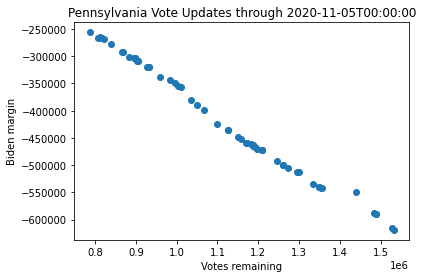

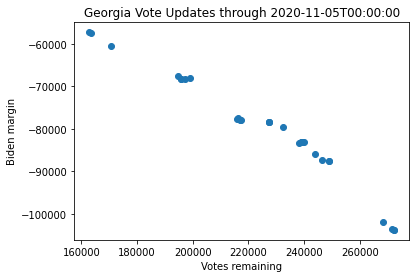

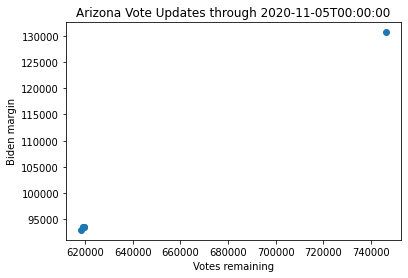

In [4]:
import matplotlib.pyplot as plt

state_list = ["Pennsylvania", "Georgia", "Arizona"]
timestamp_list = ["2020-11-05T00:00:00"]*3
iter_vals = list(zip(state_list, timestamp_list))

def plot_data(state, timestamp=None):
    "Plot the election data for a given state up through a given time"

    df = load_data(state, timestamp)

    plt.figure()
    plt.plot(df["votes_remaining"], df["vote_differential"], "o")
    plt.xlabel("Votes remaining")
    plt.ylabel("Biden margin")
    plt.title("{} Vote Updates through {}".format(state, timestamp))

for (state, tstamp) in iter_vals:
    plot_data(state, tstamp)

Note that the trend shows that Biden is catching up as more votes are counted
in both Georgia and Pennsylvania, while Trump is catching up in Arizona.
The trend is fairly linear. Thus, one might first consider doing a simple
regression to estimate the final margin.

## Linear Regression Analysis

We can do a simple analysis based on this. A linear regression model will
have two parameters that are fit: the slope will be related to the fraction
of the outstanding votes that are for Biden, and the intercept, which
will indicate the final margin when there are no votes remaining. (This is
the initial analysis that was done by Camila for Pennsylvania and Martin for
Arizona.)

Predicted margin for Pennsylvania as of 2020-11-05T00:00:00: 139881.6546047934
Predicted margin for Georgia as of 2020-11-05T00:00:00: 11362.338299788968
Predicted margin for Arizona as of 2020-11-05T00:00:00: -87876.9014304029


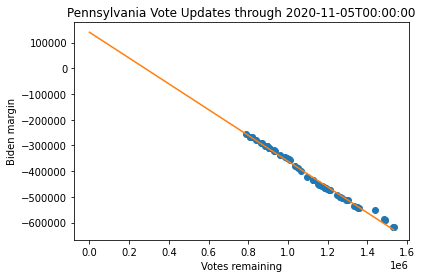

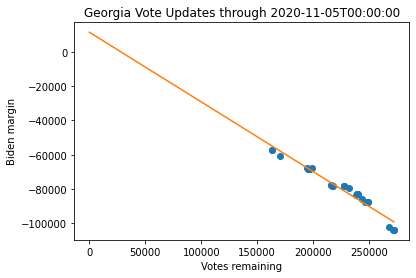

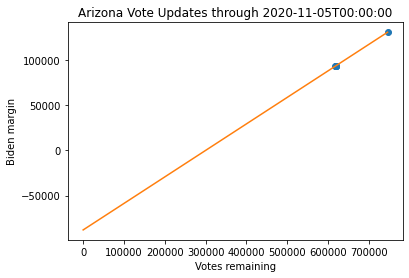

In [5]:
import numpy as np

def linear_regression(state, timestamp=None):
    """
    Fit a linear regression model to the election updates

    Fits a line to the data updates for a given state and a given
    timestamp. Plots the data and returns the fitting parameters
    (slope, intercept) as a numpy array.
    """

    plot_data(state, timestamp)

    df = load_data(state, timestamp)

    coeffs = np.polyfit(df["votes_remaining"], df["vote_differential"], 1)

    plotvals = np.linspace(0, df["votes_remaining"].iloc[-1])

    plt.plot(plotvals, coeffs[0]*plotvals + coeffs[1])

    return coeffs

for (state, tstamp) in iter_vals:
    coeffs = linear_regression(state, tstamp)
    print("Predicted margin for {} as of {}: {}".format(state, tstamp, coeffs[1]))

Note that at this point, the linear regression predicts a margin in
Pennsylvania and Arizona that are quite different from the final margin.
Georgia appears to be very close to the final margin. However, Arizona
seems to have outlier points that muddles this analysis (which was first
noted by Martin). Thus, while these models are useful starting points, they
do not appear to be particularly robust and are somewhat dependent on when
you choose to fit the data.

In [6]:
def get_margin(state, timestamp=None):
    "Extract margin for a state at a given time"
    
    df = load_data(state, timestamp)
    
    return df["vote_differential"].iloc[0]

for state in state_list:
    print("Current margin in {}: {}".format(state, get_margin(state)))

Current margin in Pennsylvania: 81660
Current margin in Georgia: 11779
Current margin in Arizona: 10457


However, one thing to note about this is that even though the trends point
clearly in favor of Biden in this analysis, we do not have a good idea of
the uncertainties. Without this, one cannot comfortably call a state in
favor of one candidate, which is why the media waited several days beyond
the election to call the states for Biden, as the only way to be sure in
this case is to wait for the margin to surpass the number of remaining
votes. How might we develop a model that explicitly captures this
uncertainty? And given such a model, when can we be confident in the
result, and how does it align with the narrative from the news media?
The following describes one approach for doing so.

## Modelling Uncertainty in the Votes

To address this shortcoming, we turn to Bayesian Inference. Bayesian
statisticians think of model parameters not as a single number, but rather
probability distributions -- in this way, we can get a sense of the range
of values that the model thinks are consistent with the data.

### Model Structure

As noted above, the regression model has two different parameters: the slope
(related to the fraction of votes that are cast for Biden), and the intercept
(which is essentially the prediction of the final margin). Note that while
our linear regression fit these two things simultaneously, there is no reason
why we had to let the final margin be a "free" parameter that we adjusted
in the fitting: we could have instead just fit a single parameter for
the slope (for instance, simply using the fraction of mail ballots cast thus
far), and then used that estimate to project the votes remaining in order to
extrapolate and obtain our estimate of the final margin.

With this format in mind, we need to develop a way to account for the
uncertainty in both of these steps. Our Bayesian model will treat both
the probability that a vote goes for Biden as a probability distribution
(rather than a single number), and then the final projected margin will
also be a probability distribution. In practice, rather than determining
the analytical form of these probability distributions, we will instead
model the outcome by drawing samples from the distribution. This is a
standard method within Bayesian Inference, and illustrates the power
of this technique for quantifying uncertainty.

### Bayesian Model of the Vote Probability

Bayesian Inference tends to think of probability distributions as reflecting
statements about our beliefs. Formally, we need to state our initial beliefs
before we see any data, and then we can use that data to update our knowledge.
This previous belief is known as a *prior* in Bayesian inference, and the
updated beliefs once we look at our data is known as the *posterior*.

#### Bayesian Inference

Bayesian Inference involves taking our previous beliefs about a system,
described by a probability distribution of reasonable values we expect
a particular parameter to take, and then using the data that we have to
update our beliefs about the distribution that we expect that parameter
to take by computing the *posterior*. This involves applying Bayes'
rule:

$$ p(\theta|y) = \frac{p(y|\theta)p(\theta)}{p(y)} $$

Here, $p(\theta)$ is the prior distribution (which we will specify before
we look at the data), $p(y|\theta)$ is the *likelihood* (the probability
that we would have gotten the data given a particular choice of $\theta$),
and $p(y)$ is known as the *evidence* (the probability of getting that
particular observation over all possible outcomes of the experiment).
For many problems, it is straightforward to specify a prior and to compute
the likelihood, while computing the evidence can be tricky.

In practice, for most models we cannot compute the evidence very easily,
so instead of computing the posterior directly, we draw samples from it.
A common technique for this is Markov Chain Monte Carlo (MCMC) sampling.
A number of software libraries have been written in recent years to make
carrying out this sampling straightforward using what are known as
*probabilistic programming languages*. These languages formally treat
variables as probability distributions with priors and then draw samples
from the posterior to allow us to perform inference.

#### A Hierarchical Bayesian Model For Voting

In our linear regression model, we effectively treated the vote probability
as a single, unchanging value. This is the same as saying that every voter
in our model is identical. Given the political polarization in the US, this
is probably not a very good assumption. Although the data seems to strongly
suggest that the mail-in votes are consistently in favor of one candidate,
this is not the same as saying all voters are identical. In the following,
we build a model to relax this assumption, using what is known as a
*hierarchical* Bayesian model.

If the above model of assuming that every voter is identical is one extreme,
then the other extreme is to assume that every voter is different and we would
need to estimate hundreds of thousands to millions of parameters to fit our
model. This is not exactly practical, so a hierarchical model posits a middle
ground that the vote probability is itself drawn from a probability
distribution. Note that this goes a step further than simply making the
model Bayesian by treating the vote probability as a probability
distribution -- in the model, each incremental update of votes has a single
vote probability associated with it, but that probability is drawn from a
probability distribution and thus can vary. By quantifying this variability
we will be able to estimate the uncertainty in the final outcome.

In the following, we model the vote probability by assuming that each vote
update has a single vote probability associated with it, and that vote
probability is drawn from a beta distribution. A beta distribution is
a distribution defined over the interval $[0,1]$ with two shape parameters
$a$ and $b$ that lets us flexibly specify a wide range of outcomes. If
$a$ and $b$ are less than 1, then the distribution is biased towards
the extreme values of 0 or 1, while if they are greater than 1 then the
distribution is biased towards 0.5. If $a > b$, then the model is more
biased towards 1, while if $b > a$ then the model is biased towards 0.
Thus we can specify a range of distributions with just two parameters.

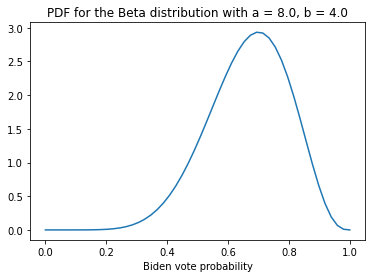

In [7]:
from scipy.stats import beta

def plot_beta(a, b):
    "plot the beta distribution for shape paramters (a, b)"
    
    xvals = np.linspace(0, 1)

    plt.plot(xvals, beta.pdf(xvals, a=a, b=b))
    plt.xlabel("Biden vote probability")
    plt.title("PDF for the Beta distribution with a = {}, b = {}".format(a, b))
    
plot_beta(8., 4.)

Thus, instead of estimating the vote probability, we instead need to
estimate $a$ and $b$, which will tell us what we expect the distribution
of the vote probability to be. Once we have estimates for those
parameters, we can forecast the remaining votes by repeatedly drawing
the vote probability from the appropriate beta distributions. Having
multiple levels like this are why these models are known as
*hierarchical* -- parameters are drawn from distributions whose parameters
are also distributions themselves.

Since all parameters in a Bayesian model must have priors, our task
is now to encode our prior beliefs about the vote probability by setting
prior distributions for $a$ and $b$.

##### Prior

Often, in Bayesian inference we don't have strong feelings about what
values we might expect for a parameter. In those cases, we often try to use
something simple, what is known as an *uninformative* prior. These might be
expressed as a statement like "every value is equally probable". Or in this
case we might assume that our prior for the vote probability should be
peaked close to 0.5, and then taper off towards 0 and 1, with the argument
that US presidential elections are usually decided by a few percentage points
difference in the national popular vote. This might seem very reasonable
on the surface, as America is pretty evenly divided between Democrats and
Republicans.

However, mail in votes in practice can be extremely biased towards
one party. Historically, a large majority of mail in ballots are
Democratic, for a variety of reasons. Trump also spent much of the
campaign sowing doubt about mail-in ballots (telegraphing his post-election
strategy of trying to throw them out in court), so his supporters may be
much less likely to vote in this manner. However, there could also be a
situation where the mail-in ballots fall heavily towards a Republican candidate
(as we have seen already, more of the Arizona ballots tend to be in favor
of Trump). Thus, based on this I would argue that what we actually want is a
prior that is reasonably likely to include some extremes in the vote
probability to ensure that our estimate of the final outcome prior to
looking at the data doesn't exclude a significant swing.

This issue illustrates a challenge with Bayesian Hierarchical models --
when the parameter that we have some knowledge about is itself described by
a distribution, the priors for the distribution parameters can be more
difficult to specify. For this reason, modellers often go one level
further and specify prior distributions on the parameters used to specify
the priors on the model parameters, which are known as *hyperpriors*, and
see how varying the priors changes the outcome of inference. We will not
explore this level of Bayesian modelling, but it should suffice to say that
I tried a number of different choices for the priors before arriving at
something that I thought accurately reflected my prior beliefs about the
outcome.

In the priors that I finally settled on, I use a Lognormal distribution
for my prior on $a$ and $b$. I choose the parameters of the lognormal
distributions for $a$ and $b$ to be slightly different such that more likely
to give a democratically-leaning distribution, but still have a decent chance
of producing extremes for Trump. I also choose the parameters such that
we get a mix of values more biased towards the extremes as well as those
biased towards values closer to 0.5. This should accurately reflect our
prior uncertainty in the outcome, as we think there is a decent chance
based on historical data that the mail votes are heavily in favor of one
candidate. Here are some histograms showing single samples of the vote
probability drawn from this prior, and an aggregate histogram of 100 samples:

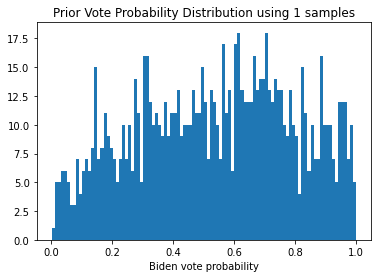

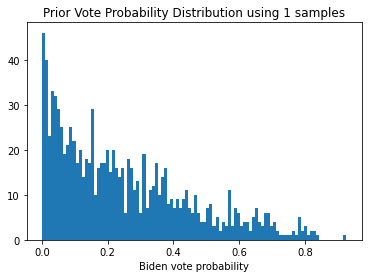

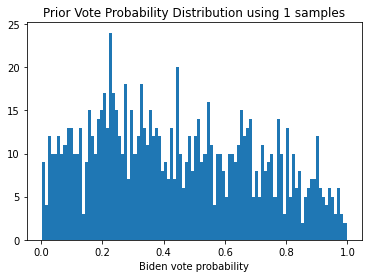

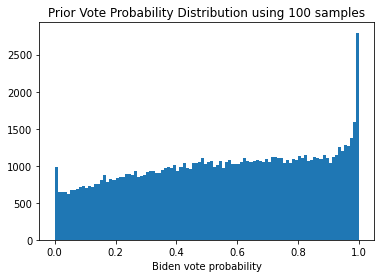

In [8]:
from pymc3 import Lognormal

def plot_prior_samples(n_samples):
    "plot a random draw of the vote probability from the prior"

    a = Lognormal.dist(mu=0.4, sd=0.5).random(size=n_samples)
    b = Lognormal.dist(mu=0.2, sd=0.5).random(size=n_samples)

    x = np.linspace(0., 1.)
    
    plt.figure()
    plt.hist(beta.rvs(size=(1000, n_samples), a=a, b=b).flatten(), bins=100)
    plt.xlabel("Biden vote probability")
    plt.title("Prior Vote Probability Distribution using {} samples".format(i))

for i in [1, 1, 1, 100]:
    plot_prior_samples(i)

From these individual samples, as well as the aggregated histogram,
we see that we get a range of outcomes, with a slight bias
towards those that favor democrats. As we acquire enough data to reliably
estimate the underlying distribution of the vote probabilites, we should
see better estimates of the true distribution, which will eliminate
more of the extremes and reduce the uncertainty in the final outcome.

##### Likelihood

Finally, we need to explicitly model the likelihood. When you flip a fair
coin a number of times, the distribution of outcomes follows a binomial
distribution. Thus, we can use a binomial likelihood to model the
range of vote probabilites that might be consistent with the votes that
were cast. This can be computed analytically, and most probabilistic
programming languages have built-in capacity for computing likelihoods
of this type. This is done by setting this particular variable to have a
known value, which indicates to the probabilistic programming language
that this variable is used to compute the likelihood. In our particular
case, this likelihood will be a vector of a series of trials, each with a
different value of the vote probability.

##### PyMC3 Implementation

Thus, we can now write down a model in a probabilistic programming language
in order to draw samples from the posterior. There are a number of popular
lanaguages for this -- here I use PyMC3 to implement my model. PyMC3
can easily handle all of the features we specified above (hierarchical
structure, and a vector representation of the binomial likelihood), which
is written out in the function below:

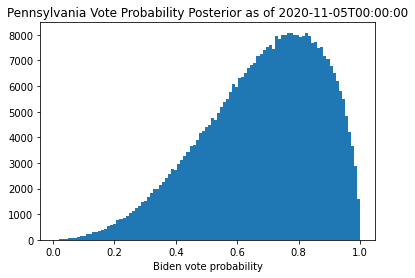

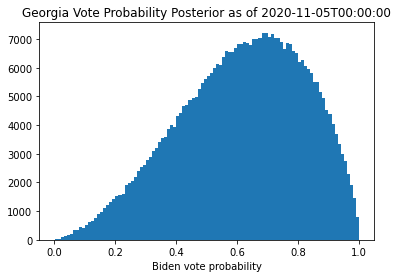

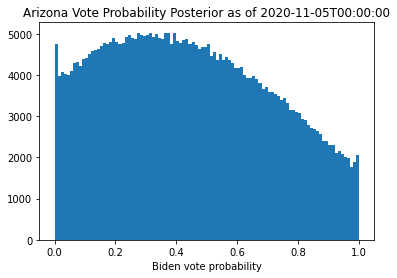

In [9]:
import pymc3

import logging
logger = logging.getLogger("pymc3")
logger.propagate = False
logger.setLevel(logging.ERROR)

def extract_n_k_trials(state, timestamp=None):
    """
    Convert vote data into a series of bernoulli trials. If no
    data is valid, then return a list of a single zero for each.

    Returns two lists of positive integers for the total number
    of votes (n) and the votes for Biden (k)
    """

    df = load_data(state, timestamp)

    # convert raw vote counts into a series of trials (n, k),
    # where n is the total number of votes and k is the number
    # of votes for Biden

    n = np.diff(-df["biden_votes"]) + np.diff(-df["trump_votes"])
    k = np.diff(-df["biden_votes"])

    # throw out sets that don't make any sense; if none remain then use (0,0)

    keep = (n > 0)*(k >= 0)*(k <= n)
    n = n[keep]
    k = k[keep]

    if len(n) == 0:
       n = [0]
       k = [0]

    return np.array(n, dtype=np.int64), np.array(k, dtype=np.int64)

def estimate_theta_hierarchical(state, timestamp=None):
    "estimate the vote probability distribution using a hierarchical model and MCMC sampling"

    n, k = extract_n_k_trials(state, timestamp)

    # build model and draw MCMC samples

    with pymc3.Model() as model:
        a = pymc3.Lognormal("a", mu=0.4, sd=0.5)
        b = pymc3.Lognormal("b", mu=0.2, sd=0.5)
        theta = pymc3.Beta("theta", alpha=a, beta=b, shape=len(n)) 
        obs = pymc3.Binomial("obs", p=theta, n=n, observed=k, shape=len(n))
        trace = pymc3.sample(1000, progressbar=False)

    return trace

def plot_posterior(state, timestamp):
    "plot the posterior distribution of the vote probability"

    trace = estimate_theta_hierarchical(state, timestamp)

    rvs_size = (100, len(trace["a"]))
    
    plt.figure()
    plt.hist(beta.rvs(size=rvs_size,
                      a=np.broadcast_to(trace["a"], rvs_size),
                      b=np.broadcast_to(trace["b"], rvs_size)).flatten(),
                      bins=100)
    plt.xlabel("Biden vote probability")
    plt.title("{} Vote Probability Posterior as of {}".format(state, timestamp))
    
for (state, tstamp) in iter_vals:
    plot_posterior(state, tstamp)

Once I draw MCMC samples for $a$ and $b$, I convert those samples into samples
of $\theta$ to see our posterior estimate of the vote probability.

Looking at these plots, we see that the model is now much more varied in
its estimates for the vote probability (note that this is the posterior for
the *distribution* expected for the vote probability, rather than the explicit
values of the vote probability itself). The mean is still where we expected
it from the linear regression analysis, but the distribution is much wider
due the fact that occasionally votes come in from places that are not as
heavily in favor of Biden (or Trump in the case of Arizona). This should
considerably increase the spread of the predicted final margin and assure
that it is not overconfident in the final result.

### Predicting the Final Margin

Once we have samples from the vote probability, we need to simulate the
remaining votes to predict the final outcome. This is known as estimating the
*posterior predictive distribution* in Bayesian inference, as we use our
updated knowledge about one of our model parameters to predict some of the
data that it was fit on.

What is a reasonable way to simulate the remaining votes? As we see from the
data, the votes come in a steady drip feed as ballots are counted. Thus,
we can simulate this by sampling randomly, with replacement, from the data
for the number of ballots cast in each update until we get to the number of
votes remaining. We can then use our posterior samples of $a$ and $b$ to
generate the distribution of vote probabilities, and then draw from the
vote probabilites to forecast the outcome of each batch of votes using a
binomial distribution. We repeat this process 10 times to ensure that the
result isn't dependent on the particular realization of the drip feed
simulation, and aggregate those samples to get the final estimate of the
posterior predictive distribution. This should give a reasonable estimate of
the final outcome based on our model.

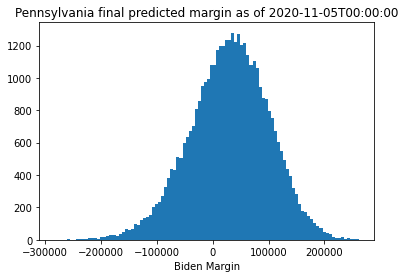

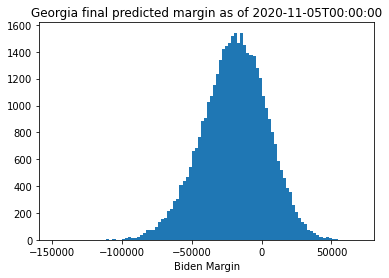

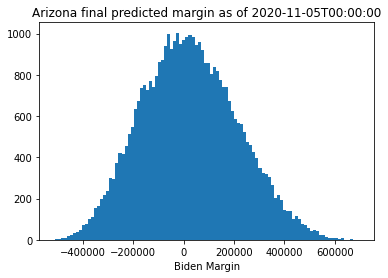

In [10]:
from scipy.stats import binom

def get_votes_remaining(state, timestamp=None):
    "Extract remaining votes for a state at a given timestamp"
    
    df = load_data(state, timestamp)

    return df["votes_remaining"].iloc[0]

def predict_final_margin(trace, state, timestamp=None):
    """
    Use posterior samples of the vote probability to predict the remaining
    votes.

    The remaining votes are split into batches by sampling from
    the previous votes until enough are accumulated. Then each batch is
    forecast using the posterior samples, and the total is summed.

    Returns a numpy array of samples of the final margin
    """

    assert np.all(trace["a"] >= 0.)
    assert np.all(trace["b"] >= 0.)

    n_remain = get_votes_remaining(state, timestamp)
    
    margin = get_margin(state, timestamp)

    n, k = extract_n_k_trials(state, timestamp)
    
    if np.all(n == 0):
        n = np.array([1000], dtype=np.int64)
    
    # simulate remaining votes

    n_trials = 10

    predicted_margin = np.zeros((n_trials, len(trace["a"])))

    for i in range(n_trials):
        trials_remain = []
        
        while np.sum(trials_remain) <= n_remain:
            trials_remain.append(np.random.choice(n))
            
        trials_remain[-1] = n_remain - np.sum(trials_remain[:-1])
        assert np.sum(trials_remain) == n_remain
    
        trials_remain = np.array(trials_remain, dtype=np.int64)
    
        rvs_size = (len(trace["a"]), len(trials_remain))
    
        predicted_margin[i] = np.sum(binom.rvs(size=rvs_size,
                                               p=beta.rvs(size=rvs_size,
                                                          a=np.broadcast_to(trace["a"][:, np.newaxis], rvs_size),
                                                          b=np.broadcast_to(trace["b"][:, np.newaxis], rvs_size)),
                                               n=np.broadcast_to(trials_remain, rvs_size)), axis=-1)

    return margin - n_remain + 2*predicted_margin.flatten()

def plot_predictions(state, timestamp):
    "plot the posterior predictive distribution for the given state and time"

    trace = estimate_theta_hierarchical(state, timestamp)
    predicted_margin = predict_final_margin(trace, state, timestamp)
    
    plt.figure()
    plt.hist(predicted_margin, bins=100)
    plt.xlabel("Biden Margin")
    plt.title("{} final predicted margin as of {}".format(state, timestamp))
    
for (state, tstamp) in iter_vals:
    plot_predictions(state, tstamp)

As we can see from this, the model has fairly wide intervals surrounding the
predicted final margin based on the original linear regression model.
Interestingly, when we fit Georgia in this way, it looks much more likely that
Trump would win through this point than the linear regression model would
suggest, though the final margin found by the regression analysis is well
within the error bounds suggested from the predictions. Arizona looks up for
grabs, indicating that the outlier points were definitely biasing the
regression analysis. Pennsylvania is much more firmly leaning towards Biden.
We can look at the results again a day later to see how the race evolved:

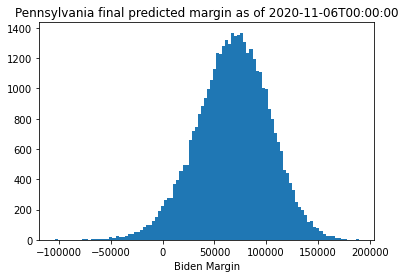

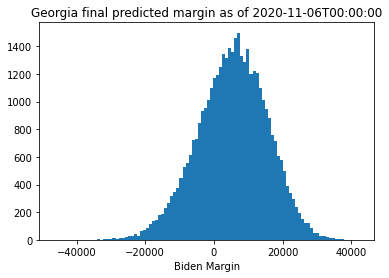

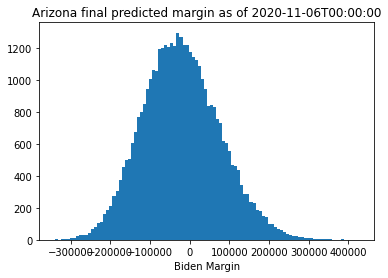

In [11]:
for (state, tstamp) in zip(state_list, ["2020-11-06T00:00:00"]*3):
    plot_predictions(state, tstamp)

Clearly, Georgia has swung in Biden's favor over the course of the day.
The mean final margin in Pennsylvania has not moved much, though the
uncertainty has tightened up and made the result more likely for Biden.
Arizona could still go either way.

## Animating the Updates

Now that we have built a model, we can build an animation that shows the
evolution of the predicted results as a function of time. This will show
how the uncertainty shrinks over time as fewer votes remain. I check
for results every 30 minutes for the 12 days from 4 November onward,
and update the model when new ballots are found. I also compute
a Biden win probability and show the mean margin $\pm$ 2 standard deviations
to give an idea of the equivalent regression result and its uncertainty.

**Note:** Because new MCMC samples need to be drawn for each new update,
creating this animation ends up being fairly expensive to run (this took
several hours on my laptop). I speed things up by saving the current
prediction each time the MCMC samples are drawn, so that if the previous
iteration is the same we do not need to re-run the model. However, this
is still fairly expensive, so don't try and run this unless you are willing
to wait!

In [12]:
%%capture

import matplotlib.path as path
import matplotlib.patches as patches
import matplotlib.text as text
import matplotlib.animation as animation

def fit_model(state, timestamp=None, initialize=False):
    """
    Fit a model to predict the final margin for the given date/time.
    Each iteration is saved as a numpy file, and the next step
    checks for a model that matches the existing vote count before
    doing the expensive MCMC fitting

    Returns the simulated final margin samples at the given time
    """

    n_prev = None
    k_prev = None
    n_predict_prev = None
    preds_prev = None
    
    if not initialize:
        try:
            model = np.load("model.npz")
            n_prev = model["n"]
            k_prev = model["k"]
            n_predict_prev = int(model["n_predict"])
            preds_prev = model["preds"]
        except (KeyError, IOError):
            n_prev = None
            k_prev = None
            n_predict_prev = None
            preds_prev = None

    n, k = extract_n_k_trials(state, timestamp)

    n_predict = get_votes_remaining(state, timestamp)
    
    if (np.array_equal(n_prev, n) and np.array_equal(k_prev, k) and
        n_predict_prev == n_predict):
        return preds_prev
    else:
        theta = estimate_theta_hierarchical(state, timestamp)
        preds =  predict_final_margin(theta, state, timestamp)
        np.savez("model.npz", n=n, k=k, preds=preds, n_predict=n_predict)
        return preds

def initialize_bins(counts, bins):
    "initialize the patch corners for the animation"

    # get the corners of the rectangles for the histogram
    left = bins[:-1]
    right = bins[1:]
    bottom = np.zeros(len(left))
    top = bottom + counts
    nrects = len(left)

    nverts = nrects * (1 + 3 + 1)
    verts = np.zeros((nverts, 2))
    codes = np.full(nverts, path.Path.LINETO)
    codes[0::5] = path.Path.MOVETO
    codes[4::5] = path.Path.CLOSEPOLY
    verts[0::5, 0] = left
    verts[0::5, 1] = bottom
    verts[1::5, 0] = left
    verts[1::5, 1] = top
    verts[2::5, 0] = right
    verts[2::5, 1] = top
    verts[3::5, 0] = right
    verts[3::5, 1] = bottom

    return verts, codes, bottom

def create_animation(state):
    "Create an animation of the vote updates for the given state"

    start_time = "2020-11-04T14:00:00"
    
    preds = fit_model(state, start_time, initialize=True)
    
    xlim = 100000
    ylim = 500
    nbins = 200

    bins_b = np.linspace(0, xlim, xlim//nbins, dtype=np.int64)
    counts_b, bins_b = np.histogram(preds[preds > 0], bins_b)

    bins_t = np.linspace(-xlim, 0, xlim//nbins, dtype=np.int64)
    counts_t, bins_t = np.histogram(preds[preds < 0], bins_t)
    
    verts_t, codes_t, bottom_t = initialize_bins(counts_t, bins_t)
    verts_b, codes_b, bottom_b = initialize_bins(counts_b, bins_b)

    patch_t = None
    patch_b = None

    def animate(i, state, bins_t, bins_b, bottom_t, bottom_b, start_time):
        # simulate new data coming in
        
        hours = i//2
        minutes = 30*i % 60
        
        timestamp = ((datetime.datetime.strptime(start_time, "%Y-%m-%dT%H:%M:%S") +
                      datetime.timedelta(hours=hours, minutes=minutes)).strftime("%Y-%m-%dT%H:%M:%S"))

        n_remain = get_votes_remaining(state, timestamp)

        preds = fit_model(state, timestamp)

        n_t, bins_t = np.histogram(preds, bins_t)
        top_t = bottom_t + n_t
        verts_t[1::5, 1] = top_t
        verts_t[2::5, 1] = top_t

        n_b, bins_b = np.histogram(preds, bins_b)
        top_b = bottom_b + n_b
        verts_b[1::5, 1] = top_b
        verts_b[2::5, 1] = top_b

        date_text.set_text(datetime.datetime.strptime(timestamp, "%Y-%m-%dT%H:%M:%S").strftime("%Y-%m-%d %H:%M"))
        vote_text.set_text("{} Votes Remaining".format(str(n_remain)))

        mean_text.set_text("Margin = {:>8} $\pm$ {:>7}".format(int(np.mean(preds)),
                                                        int(2.*np.std(preds))))
        prob_text.set_text("Biden win prob = {:.2f}".format(np.sum(preds > 0)/len(preds)))
        
        return [patch_t, patch_b, date_text, vote_text, mean_text, prob_text]

    fig, ax = plt.subplots()
    barpath_t = path.Path(verts_t, codes_t)
    patch_t = patches.PathPatch(barpath_t, facecolor='C3',
                              edgecolor='C3', alpha=0.5)
    ax.add_patch(patch_t)
    barpath_b = path.Path(verts_b, codes_b)
    patch_b = patches.PathPatch(barpath_b, facecolor='C0',
                              edgecolor='C0', alpha=0.5)
    ax.add_patch(patch_b)

    date_text = text.Text(-9*xlim//10, 9*ylim//10,
                          datetime.datetime.strptime(start_time, "%Y-%m-%dT%H:%M:%S").strftime("%Y-%m-%d %H:%M"))
    ax.add_artist(date_text)

    n_remain = get_votes_remaining(state, start_time)
    vote_text = text.Text(-9*xlim//10, 8*ylim//10,
                          "{} Votes Remaining".format(str(n_remain)))
    ax.add_artist(vote_text)

    prob_text = text.Text(9*xlim//10, 9*ylim//10,
                          "Biden win prob = {:.2f}".format(np.sum(preds > 0)/len(preds)),
                          ha='right')
    ax.add_artist(prob_text)

    mean_text = text.Text(9*xlim//10, 8*ylim//10,
                          "Margin = {:>8} $\pm$ {:>7}".format(int(np.mean(preds)),
                                                        int(2.*np.std(preds))),
                          ha='right')
    ax.add_artist(mean_text)

    ax.set_xlim(-xlim, xlim)
    ax.set_ylim(0, ylim)
    ax.set_xlabel("Biden margin")
    ax.set_title("{} Final Margin Prediction".format(state))
    
    ani = animation.FuncAnimation(fig, animate, frames=2*24*12, interval=200,
                                  fargs=(state, bins_t, bins_b, bottom_t, bottom_b, start_time),
                                  repeat=False, blit=True)
    
    return ani

ani_pa = create_animation("Pennsylvania")
ani_ga = create_animation("Georgia")
ani_az = create_animation("Arizona")

There were 2 divergences after tuning. Increase `target_accept` or reparameterize.
There was 1 divergence after tuning. Increase `target_accept` or reparameterize.
There were 2 divergences after tuning. Increase `target_accept` or reparameterize.
There were 2 divergences after tuning. Increase `target_accept` or reparameterize.
There was 1 divergence after tuning. Increase `target_accept` or reparameterize.
There was 1 divergence after tuning. Increase `target_accept` or reparameterize.
There was 1 divergence after tuning. Increase `target_accept` or reparameterize.


Displaying these, we can see how the race evolves over time.

In [13]:
from IPython.display import HTML

HTML(ani_pa.to_jshtml())

There were 3 divergences after tuning. Increase `target_accept` or reparameterize.
There was 1 divergence after tuning. Increase `target_accept` or reparameterize.
There were 7 divergences after tuning. Increase `target_accept` or reparameterize.
There were 10 divergences after tuning. Increase `target_accept` or reparameterize.
There was 1 divergence after tuning. Increase `target_accept` or reparameterize.
There were 2 divergences after tuning. Increase `target_accept` or reparameterize.
There were 2 divergences after tuning. Increase `target_accept` or reparameterize.
There were 2 divergences after tuning. Increase `target_accept` or reparameterize.
There were 4 divergences after tuning. Increase `target_accept` or reparameterize.
There was 1 divergence after tuning. Increase `target_accept` or reparameterize.
There were 2 divergences after tuning. Increase `target_accept` or reparameterize.
There was 1 divergence after tuning. Increase `target_accept` or reparameterize.
There were 

In [14]:
HTML(ani_ga.to_jshtml())

There was 1 divergence after tuning. Increase `target_accept` or reparameterize.


In [15]:
HTML(ani_az.to_jshtml())

There were 3 divergences after tuning. Increase `target_accept` or reparameterize.
There was 1 divergence after tuning. Increase `target_accept` or reparameterize.
There was 1 divergence after tuning. Increase `target_accept` or reparameterize.


Based on this model, we can see that Pennsylvania was very clearly going
in Biden's direction from early on, despite Trump's substantial lead at the
end of Election Day. This was reflected by comments made by other election
data journalists, all of whom were fairly confident that the numbers were
good news for Biden even as early as 4 November. Biden's win probability
steadily increased, surpassing 99% on 6 November. The media called
the state, and the election, for Biden on 7 November.

Georgia, on the other hand, was not a sure thing. For much of the early data,
our model favored Trump, who had a win probability of 82% on the evening of
4 November. However, the uncertainties were wide enough at that point that
Biden's eventual victory was still not an unreasonable outcome. As the
ballots shifted towards Biden, we can see a clear change on 5 November,
and by that evening Biden's win probability was 70%. Biden's chances
steadily increased and surpassed 99% on the evening of 7 November. However,
since the final margin was still fairly small in absolute terms, the media
did not call Georgia until 12 or 13 November.

Arizona, despite being the first state among these that many news outlets
called, showed the largest uncertainties for much of the time period we
have data, with no candidate having a clear advantage until 9 November when
Biden took a slight lead in the model predictions. From there, Biden inched
ahead as the remaining ballots came in, and the outcome shifted clearly in
his favor on 12 November with his win probability exceeding 99% that evening.
The remaining media outlets called Arizona for Biden on 13 November.

As we can see, our model is able to call the outcome of these states slightly
before the media does so (possibly due to some level of conservatism).
Seeing the range of uncertainties shrink is helpful to know what range of
outcomes could still be reasonably expected, and can be a much more interesting
way to visualize the results (particularly when animated as above).

## Conclusion

This Data Story examined how we could build a simple Bayesian hierarchical
model for the US election data and use it to forecast the final outcome.
The model showed how the outcome in three key battleground states evolved
over the week following the election as mail ballots were counted, tipping
the election in favor of Biden. Because the model includes uncertainties
and prior beliefs about voting behavior, this gave a richer picture of how
to forecast the final result than simply extrapolating using early returns
(with considerable more thought and effort required, however!). Because
of the time scales over which the election played out, we could imagine
having put this in place to make prospective predictions (stay tuned for
2024!) in real time to see how this simple model aligns with more experienced
election forecasters.